# Convert forecasts
This notebook is used to convert quantile forecasts to a parametric forecast that can be used as the input for the optimization process.

## Data Read-In

In [1]:
import pandas as pd
import numpy as np
import glob  as glob
import os
import matplotlib.pyplot as plt
from scipy.optimize import minimize
import plotly.graph_objects as go
import scipy.optimize
import inspect
import os
from datetime import datetime

print("Current working directory: ", os.getcwd())

def read_in_data(path):
    forecast = pd.read_csv(path, index_col=0, parse_dates=True)
    forecast.index = pd.to_datetime(forecast.index)
    return forecast

Current working directory:  c:\Users\fh6281\PycharmProjects\Day-Ahead-Battery-Scheduling\forecasting


In [2]:
path_forecast = '../data/quantile_forecasts/residential4_model_2024-10-02_13_27_31_torch_model_run_3687549.csv'
path_gt = '../data/ground_truth/residential4_prosumption.csv'

forecast = read_in_data(path_forecast)
forecast.columns = forecast.columns.str.replace('0_', '') # rename columns 0_0.01- 0_0.99 to 0.01 - 0.99
forecast.columns = forecast.columns.astype(float)

# Get the current date
current_date = datetime.now().strftime('%Y-%m-%d')

gt = read_in_data(path_gt)

## Vizualisation

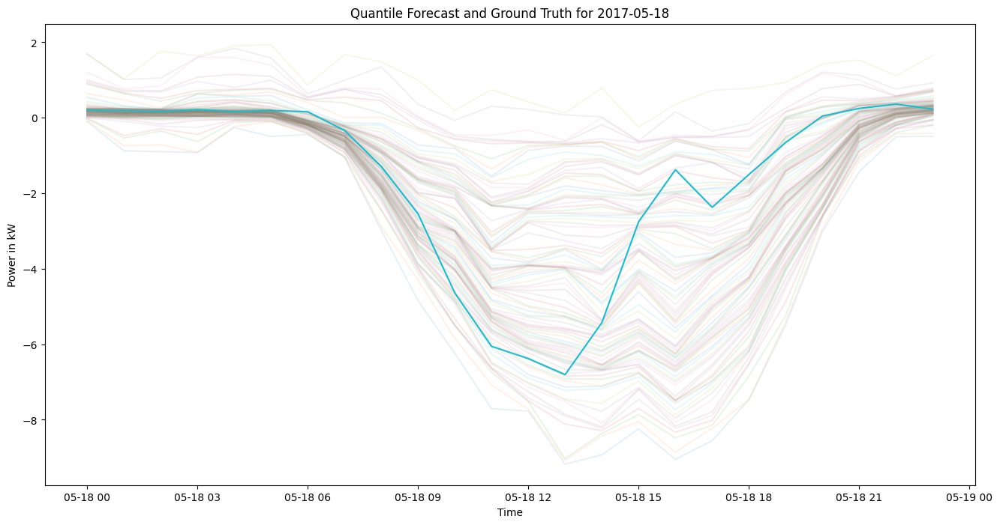

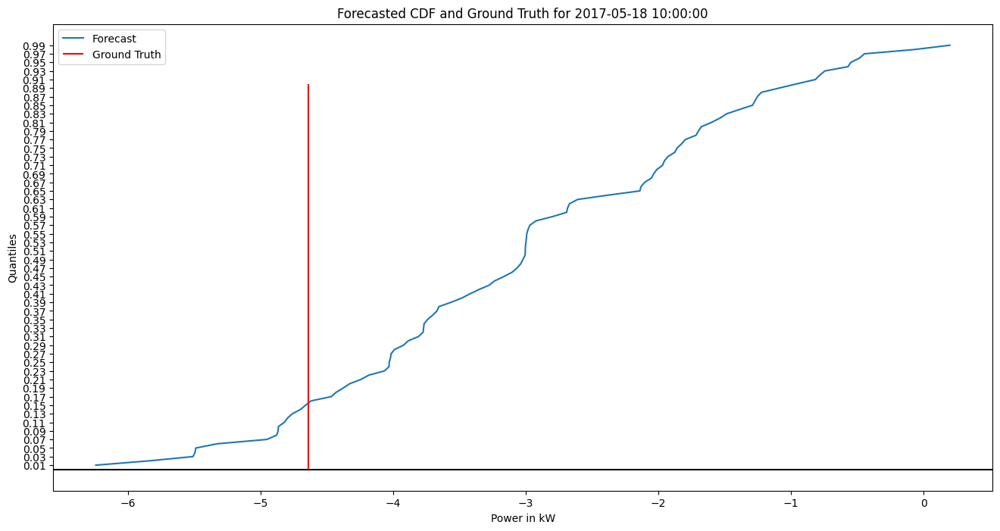

In [4]:
def plot_specific_day(fc_df, gt_df, day, title=None):
    plt.figure(figsize=(16,8))
    plt.plot(fc_df.loc[day], label='Forecast', alpha=0.1)
    plt.plot(gt_df.loc[day], label='Ground Truth', alpha=1)
    plt.ylabel('Power in kW')
    plt.xlabel('Time')
    if title is not None:
        plt.title(title)
    plt.show()

# create an viszualisation of every hour given a forecast containing the quantiles 0.01 to 0.99
def plot_forecast_hour(fc_df, gt_df, day_and_hour, title=None):
    plt.figure(figsize=(16,8))
    plt.plot(fc_df.loc[day_and_hour].values, fc_df.columns, label='Forecast', alpha=1)
    # plot the ground truth as horizontal line
    gt_value = gt_df.loc[day_and_hour].values[0]
    plt.axhline(y=0, color='k', linestyle='-')
    plt.vlines(x=gt_value, ymin=0, ymax=0.9, color='r', linestyle='-', label='Ground Truth')
    plt.ylabel('Quantiles')
    plt.yticks(np.arange(0.01, 1.01, 0.02))
    plt.xlabel('Power in kW')
    if title is not None:
        plt.title(title)   
    plt.legend()
    plt.show()


date_to_visualize = '2017-05-18'
date_time_to_visualize = date_to_visualize + ' 10:00:00'
plot_specific_day(forecast, gt, date_to_visualize, title=f'Quantile Forecast and Ground Truth for {date_to_visualize}')
plot_forecast_hour(forecast, gt, date_time_to_visualize, title=f'Forecasted CDF and Ground Truth for {date_time_to_visualize}')

## Sort the Quantiles

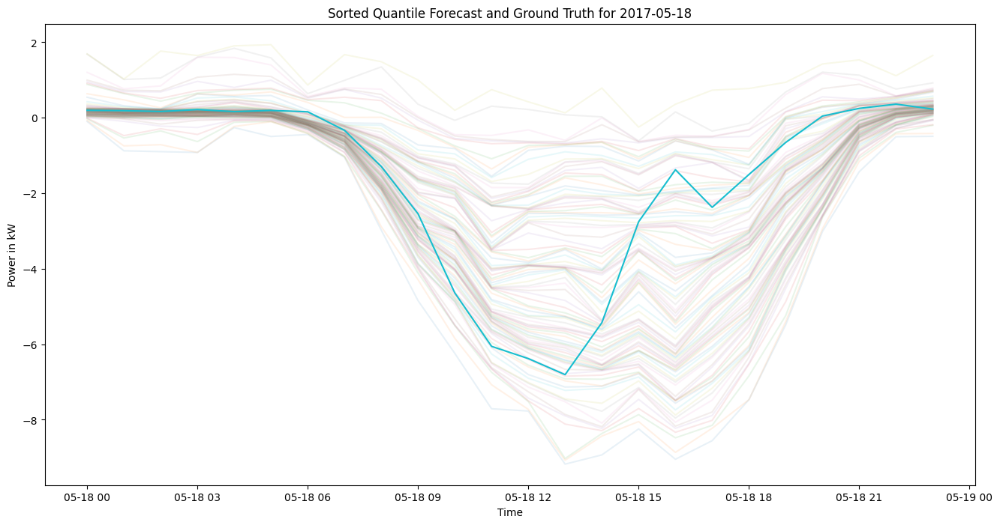

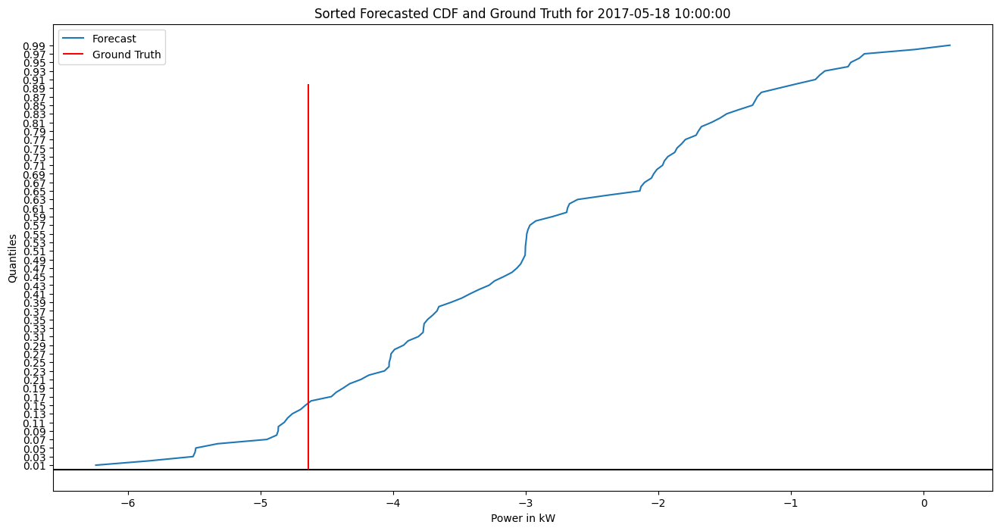

In [5]:
# go through every row of the dataframe and ensure that the values in ascending order (should be the case already => see np.quantile() docs)
def sort_quantiles(fc_df):
    # create a new dataframe
    fc_sorted = []
    # go through every row
    for index, row in fc_df.iterrows():
        # sort the values in ascending order
        sorted_values = row.sort_values()
        # add the sorted values to the new dataframe
        fc_sorted.append(sorted_values.values)
    return pd.DataFrame(fc_sorted, index=fc_df.index, columns=fc_df.columns)

# sort the forecast
forecast_sorted = sort_quantiles(forecast)

# plot the sorted forecast
plot_specific_day(forecast_sorted, gt, date_to_visualize, title=f'Sorted Quantile Forecast and Ground Truth for {date_to_visualize}')
plot_forecast_hour(forecast_sorted, gt, date_time_to_visualize, title=f'Sorted Forecasted CDF and Ground Truth for {date_time_to_visualize}')

## Smooth the quantiles

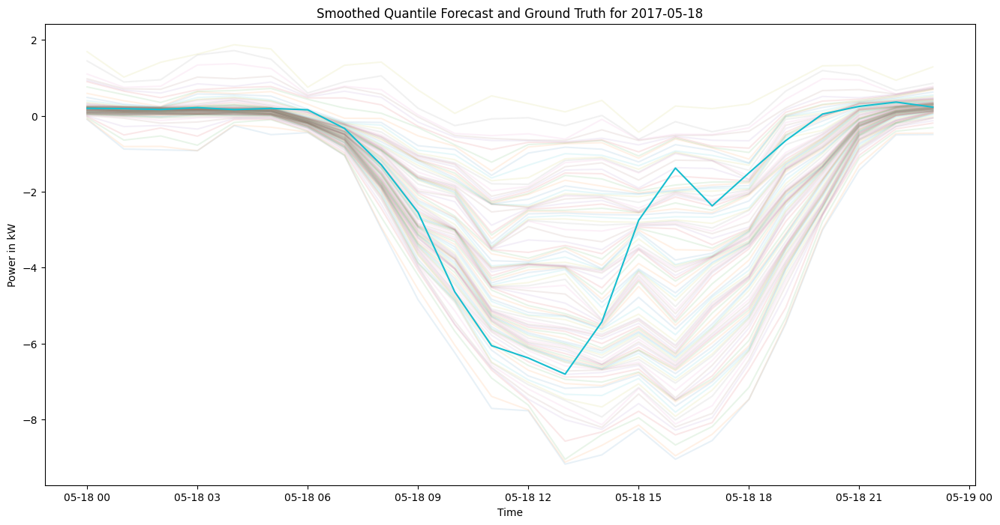

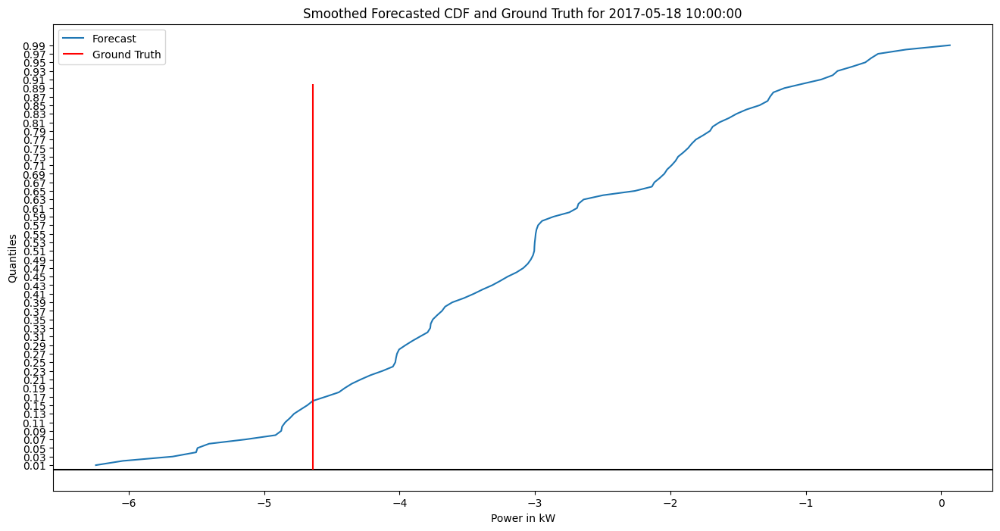

In [6]:
# go through every row of the dataframe and smooth the values
def smooth_quantiles(fc_df, window_size=2): # Paper: Window size of 2 was used
    # create a new dataframe
    fc_smoothed = []
    # go through every row
    for index, row in fc_df.iterrows():
        # smooth the values
        smoothed_values = row.rolling(window=window_size, min_periods=1, center=True).mean()
        # add the smoothed values to the new dataframe
        fc_smoothed.append(smoothed_values.values)
    return pd.DataFrame(fc_smoothed, index=fc_df.index, columns=fc_df.columns)

# smooth the forecast
forecast_smoothed = smooth_quantiles(forecast_sorted)

plot_specific_day(forecast_smoothed, gt, date_to_visualize, title=f'Smoothed Quantile Forecast and Ground Truth for {date_to_visualize}')
plot_forecast_hour(forecast_smoothed, gt, date_time_to_visualize, title=f'Smoothed Forecasted CDF and Ground Truth for {date_time_to_visualize}')


In [7]:
forecast_smoothed

,0.01,0.02,0.03,0.04,0.05,0.06,0.07,0.08,0.09,0.10,...,0.90,0.91,0.92,0.93,0.94,0.95,0.96,0.97,0.98,0.99
cest_timestamp,,,,,,,,,,,,,,,,,,,,,
2017-01-08 06:00:00,-0.479439,-0.097018,0.297752,0.311592,0.319515,0.357345,0.439222,0.529600,0.600780,0.660838,...,1.116455,1.130293,1.148906,1.165796,1.175357,1.186898,1.197371,1.216187,1.239410,1.251881
2017-01-08 07:00:00,0.317270,0.361354,0.437102,0.483351,0.548615,0.638648,0.681403,0.686489,0.700156,0.720625,...,1.141475,1.147122,1.157287,1.169648,1.224109,1.285640,1.311415,1.531923,1.799129,1.889498
2017-01-08 08:00:00,-0.597479,-0.410233,-0.093142,0.053549,0.131019,0.204749,0.365262,0.529592,0.555064,0.567282,...,1.237421,1.266816,1.285734,1.312835,1.382268,1.513141,1.810098,2.077240,2.133954,2.152934
2017-01-08 09:00:00,-0.759007,-0.695465,-0.538407,-0.441323,-0.336140,-0.169466,-0.084960,-0.044033,-0.003460,0.028523,...,1.182207,1.227066,1.305361,1.384745,1.451659,1.504093,1.544064,1.726063,1.926697,2.043442
2017-01-08 10:00:00,-2.244099,-2.082039,-1.744566,-1.523204,-1.470771,-1.459319,-1.342392,-1.197180,-1.129710,-1.043549,...,1.171013,1.182023,1.184592,1.186861,1.209823,1.328103,1.430343,1.547365,1.873688,2.090598
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-02-04 01:00:00,-0.486886,-0.349407,-0.004097,0.211460,0.221312,0.226188,0.231511,0.256730,0.292579,0.311695,...,1.015776,1.055527,1.106854,1.138531,1.232105,1.625671,1.937030,1.937030,1.937980,1.985605
2018-02-04 02:00:00,0.040341,0.127718,0.247252,0.310042,0.378004,0.417752,0.428811,0.442498,0.455798,0.470551,...,0.933463,0.974916,1.014437,1.121710,1.235330,1.342059,1.473649,1.538685,1.587412,1.784308
2018-02-04 03:00:00,-0.547202,-0.532008,-0.205503,0.158665,0.232211,0.258926,0.267589,0.273277,0.276872,0.282860,...,0.958100,1.017570,1.028182,1.038782,1.064823,1.109460,1.169770,1.314885,1.673319,1.930199


## Fit to normal distribution

In [8]:
def get_param_names(cdf):
    sig = inspect.signature(cdf._cdf)
    param_names = list(sig.parameters.keys())
    return param_names

def fit_distribution(df_row, cdf, num_params, quantiles, verbose=False):
    if quantiles is None:
        quantiles = np.linspace(0.01, 0.99, 99)
    y = df_row.values
    f = lambda y, *params: cdf(*params).cdf(y)
    params, _ = scipy.optimize.curve_fit(f, y, quantiles, p0=[1]*num_params, maxfev=20000)
    if verbose:
        plt.plot(y, quantiles, 'o')
        plt.plot(y, f(y, *params))
        plt.show()  
    return params

def fit_distributions(fc_df, cdf, num_params, quantiles=None):
    fc_fitted = []
    for index, row in fc_df.iterrows():
        params = fit_distribution(row, cdf, num_params, quantiles)
        fc_fitted.append(params)

    #print(get_param_names(cdf))
    columns = [f'param_{i}' for i in range(num_params)]
    return pd.DataFrame(fc_fitted, index=fc_df.index, columns=columns)

In [9]:
# fit to normal distribution
norm = scipy.stats.norm
#forecast_fitted = fit_distributions(forecast_smoothed, norm, 2)
forecast_fitted = fit_distributions(forecast_smoothed.loc['2017-05-01':'2017-06-01'], norm, 2)

In [ ]:
# separate the forecast into expected value forecast and standard deviation forecast
# NORMAL DISTRIBUTION
forecast_exp_values = forecast_fitted['param_0']
forecast_variance = forecast_fitted.copy()
forecast_variance['param_0'] = 0.0
forecast_variance['Approximation-Integer'] = 40 # Specifies up until which point the double factorials are calculated

# Save the forecasts to use as input for the optimization
folder_name = f'normal_dist_forecast_{current_date}'
os.makedirs('../data/parametric_forecasts/' + folder_name, exist_ok=True)

forecast_exp_values.to_csv(f'../data/parametric_forecasts/{folder_name}/expected_value_forecast.csv')
forecast_variance.to_csv(f'../data/parametric_forecasts/{folder_name}/cdf_weights.csv')

## Fit to sum of two logistic functions

In [12]:
# plot the cdf from forecast_smoothed 
fig = go.Figure()

quantiles = forecast_smoothed.loc['2017-05-18'].columns
for t, values in forecast_smoothed.loc['2017-05-18'].iterrows():
    fig.add_trace(go.Scatter(x=values.values, y=quantiles, mode='lines', name=f'Time {t.strftime('%H:%M %d-%m-%Y')}'))

fig.update_layout(
    title='CDFs - Raw forecasted Quantiles',
    xaxis_title='Prosumption-Uncertainty [kWh]',
    yaxis_title='Quantiles',
    xaxis=dict(showgrid=True, gridwidth=1, gridcolor='LightGray'),
    yaxis=dict(showgrid=True, gridwidth=1, gridcolor='LightGray'),
    legend_title_text='Timesteps',
    width=1200,  # Adjust the width of the plot
    height=400  # Adjust the height of the plot
)

In [13]:
# Add a penalty term to the optimization function to ensure that the sum of the weights is 1
def sum_2_log_cdf(x, w1, w2, w3, w4, w5, w6):
    return w1 / (1 + np.exp(-w2 * (x - w3))) + w4 / (1 + np.exp(-w5 * (x - w6)))

def plot_cdfs_from_weights(df, title='CDFs'):
    fig = go.Figure()
    x = np.linspace(-20, 20, 5000)
    for t, weights in df.iterrows():
        cdf_vals = sum_2_log_cdf(x, *weights)
        fig.add_trace(go.Scatter(x=x, y=cdf_vals, mode='lines', name=f'Time {t.strftime('%H:%M %d-%m-%Y')}'))

    fig.update_layout(
        title=title,
        xaxis_title='Prosumption-Uncertainty [kWh]',
        yaxis_title='Quantiles',
        xaxis=dict(showgrid=True, gridwidth=1, gridcolor='LightGray'),
        yaxis=dict(showgrid=True, gridwidth=1, gridcolor='LightGray'),
        legend_title_text='Timesteps',
        width=1200,  # Adjust the width of the plot
        height=600  # Adjust the height of the plot
    )

    fig.show()

In [14]:
# define custom loss function
def loss_function(params, x_data, y_data):
    w1, w2, w3, w4, w5, w6 = params
    cdf_vals = sum_2_log_cdf(x_data, w1, w2, w3, w4, w5, w6)

    penalty = np.abs(sum_2_log_cdf(1000, w1, w2, w3, w4, w5, w6) - 1)

    return np.sum((cdf_vals - y_data)**2) + penalty

time_range = ['2017-05-15', '2017-05-22']

# Compute weights with custom loss function and bounded scaleing weights
bounds = [(0, 1), (None, None), (None, None), (0, 1), (None, None), (None, None)]
quantiles = forecast_smoothed.columns.astype(float)
weights_list = []
for t, values in forecast_smoothed.loc[time_range[0] : time_range[1]].iterrows():
    weights_h = minimize(loss_function, x0=[0.4, 10, -0.2, 0.6, 1, 0.5], args=(values.values, quantiles), method='L-BFGS-B', bounds=bounds)
    weights_list.append(weights_h.x)


columns = [f'param_{i}' for i in range(len(bounds))]
df_weights = pd.DataFrame(weights_list, index=forecast_smoothed.loc[time_range[0] : time_range[1]].index, columns=columns)

C:\Users\fh6281\AppData\Local\Temp\ipykernel_20912\3537800592.py:3: RuntimeWarning:

overflow encountered in exp



In [15]:
plot_cdfs_from_weights(df_weights.loc['2017-05-18'], title='CDFs - With custom loss function and bounded weights => Not valid because does not converge to 1 (but almost)')
for index, row in df_weights.iterrows():
    print(index  ,'w1 + w4:', row['param_0'] + row['param_3'])

C:\Users\fh6281\AppData\Local\Temp\ipykernel_20912\3537800592.py:3: RuntimeWarning:

overflow encountered in exp



2017-05-15 00:00:00 w1 + w4: 1.0
2017-05-15 01:00:00 w1 + w4: 0.9999999961930783
2017-05-15 02:00:00 w1 + w4: 0.9999999949745132
2017-05-15 03:00:00 w1 + w4: 0.9991148796240947
2017-05-15 04:00:00 w1 + w4: 1.0
2017-05-15 05:00:00 w1 + w4: 1.0
2017-05-15 06:00:00 w1 + w4: 0.9999999993580095
2017-05-15 07:00:00 w1 + w4: 0.9999999982144907
2017-05-15 08:00:00 w1 + w4: 0.9999999933726236
2017-05-15 09:00:00 w1 + w4: 1.0051599942259875
2017-05-15 10:00:00 w1 + w4: 1.0
2017-05-15 11:00:00 w1 + w4: 0.9999999996830181
2017-05-15 12:00:00 w1 + w4: 1.0
2017-05-15 13:00:00 w1 + w4: 1.0
2017-05-15 14:00:00 w1 + w4: 1.014418746754101
2017-05-15 15:00:00 w1 + w4: 1.0
2017-05-15 16:00:00 w1 + w4: 1.0
2017-05-15 17:00:00 w1 + w4: 1.008208289638598
2017-05-15 18:00:00 w1 + w4: 1.0
2017-05-15 19:00:00 w1 + w4: 0.9999999976113505
2017-05-15 20:00:00 w1 + w4: 0.9999999978840841
2017-05-15 21:00:00 w1 + w4: 0.999999999999441
2017-05-15 22:00:00 w1 + w4: 1.0
2017-05-15 23:00:00 w1 + w4: 1.0
2017-05-16 00:00

In [16]:
# Ensure that the sum of the weights is 1 => This is now an approximation!
# The weights are not exactly 1 but close to 1. Change them so they add up to exactly 1
weights_corrected = []
for index, row in df_weights.iterrows():

    w1, w2, w3, w4, w5, w6 = row.values
    if w1 == 0.0 or w4 == 1.0:
        w4 = 1.0
        w1 = 0.0
        w2 = 0.0 # set to 0 because it is not used anyway but large values can cause OverflowError: (34, 'Result too large')
    elif w1==1.0 or w4 == 0.0:
        w1 = 1.0
        w4 = 0.0
        w5 = 0.0 # set to 0 because it is not used anyway but large values can cause OverflowError: (34, 'Result too large')
    else:
        avg_mismatch = (1 - (w1 + w4)) / 2
        w1 += avg_mismatch
        w4 += avg_mismatch

    weights_corrected.append([w1, w2, w3, w4, w5, w6])

columns = [f'param_{i}' for i in range(len(weights_corrected[0]))]
df_weights_corrected = pd.DataFrame(weights_corrected, index=df_weights.index, columns=columns)

# for index, row in df_weights_corrected.iterrows():
#     print(index  ,'w1 + w4:', row['param_0'] + row['param_3'])
plot_cdfs_from_weights(df_weights_corrected.loc['2017-05-18'], title='CDFs - With custom loss function and bounded weights => Valid because the sum of the weights is 1')

In [17]:
# Shift the weights so that the expected value (mean) of the CDFs is 0
weights_corrected_shifted = []
expected_vals = []
for t, weights in df_weights_corrected.iterrows():
    w1, w2, w3, w4, w5, w6 = weights
    mu1 = w3
    mu2 = w6
    expected_value = w1 * mu1 + w4 * mu2
    w3 -= expected_value
    w6 -= expected_value
    weights_corrected_shifted.append([w1, w2, w3, w4, w5, w6])
    expected_vals.append([expected_value])

columns = [f'param_{i}' for i in range(len(weights_corrected_shifted[0]))]
df_weights_corrected_shifted = pd.DataFrame(weights_corrected_shifted, index=df_weights.index, columns=columns)
df_s2l_exp_val = pd.DataFrame(expected_vals, index=df_weights.index, columns=['expected_value'])

plot_cdfs_from_weights(df_weights_corrected_shifted.loc['2017-05-18'], title='CDFs - Custom loss, bounded weights, shifted to expected value 0 => valid')

In [19]:
# Save the forecasts to use as input for the optimization
folder_name = f's2l_dist_forecast_{current_date}'
os.makedirs('../data/parametric_forecasts/' + folder_name, exist_ok=True)

df_s2l_exp_val.to_csv(f'../data/parametric_forecasts/{folder_name}/expected_value_forecast.csv')
df_weights_corrected_shifted.to_csv(f'../data/parametric_forecasts/{folder_name}/cdf_weights.csv')

## Other Approaches

### Fit Mixed Gaussian Distribution

In [ ]:
from sklearn.mixture import GaussianMixture
import plotly.graph_objects as go


def gmm_cdf(x, weights, means, covariances):
    return np.sum([w * norm.cdf(x, mean, np.sqrt(cov)) for w, mean, cov in zip(weights, means, covariances)], axis=0)


fig = go.Figure()

x_vals = np.linspace(-10, 2, 1000)
for t in forecast_smoothed.loc['2017-05-18'].index:
    # Gaussian Mixture Model with 2 distributions
    gmm = GaussianMixture(n_components=2)
    gmm.fit(forecast_smoothed.loc[t].values.reshape(-1, 1))

    weights = gmm.weights_
    means = gmm.means_.flatten()
    covariances = gmm.covariances_.flatten()

    # Generate x values and compute CDF of GMM
    cdf_vals = gmm_cdf(x_vals, weights, means, covariances)

    # Plot CDF of GMM
    fig.add_trace(go.Scatter(x=x_vals, y=cdf_vals, mode='lines', name=f'Time {t.strftime('%H:%M %d-%m-%Y')}'))

fig.update_layout(
    title='CDFs - All Time Steps',
    xaxis_title='Prosumption-Uncertainty [kWh]',
    yaxis_title='Quantiles',
    xaxis=dict(showgrid=True, gridwidth=1, gridcolor='LightGray'),
    yaxis=dict(showgrid=True, gridwidth=1, gridcolor='LightGray'),
    legend_title_text='Timesteps',
    width=1200,  # Adjust the width of the plot
    height=400  # Adjust the height of the plot
)

In [ ]:
initial_means = np.array([[0], [0]])
gmm = GaussianMixture(n_components=2, reg_covar=1e-3, means_init=initial_means, weights_init=np.array([0.5, 0.5]))	
fc_fitted = []
#forecast_test = forecast_smoothed.loc['2017-10-20':'2017-10-23']
count = 0
count2 = 0
for index, row in forecast_smoothed.loc['2017-05-01':'2017-06-01'].iterrows():
    gmm.fit(row.values.reshape(-1, 1))

    weights = gmm.weights_
    means = gmm.means_.flatten()
    covariances = gmm.covariances_.flatten()

    fc_fitted.append([*weights, *means, *covariances])

columns = ['w1', 'w2', 'mu1', 'mu2', 'cov1', 'cov2']
forecast_gmm = pd.DataFrame(fc_fitted, index=forecast_smoothed.loc['2017-05-01':'2017-06-01'].index, columns=columns)

In [ ]:
# Shift the means to the get an expected value of zero
def expected_value_gmm(df_row):
    w1, w2, mu1, mu2, cov1, cov2 = df_row
    return w1 * mu1 + w2 * mu2

fc_gmm = forecast_gmm.copy()

fc_gmm['expected_value'] = fc_gmm.apply(expected_value_gmm, axis=1)
fc_gmm['mu1_shifted'] = fc_gmm['mu1'] - fc_gmm['expected_value']
fc_gmm['mu2_shifted'] = fc_gmm['mu2'] - fc_gmm['expected_value']

fc_gmm.drop(columns=['mu1', 'mu2'], inplace=True)

# change the order of the columns
fc_gmm_exp_val = fc_gmm['expected_value']
fc_gmm_uncertainty = fc_gmm[['w1', 'w2', 'mu1_shifted', 'mu2_shifted', 'cov1', 'cov2']] 
fc_gmm_uncertainty['Approximation-Integer'] = 40 # Specifies up until which point the double factorials are calculated

fc_gmm_uncertainty


# save the paramteric forecasts
# fc_gmm_exp_val.to_csv('../data/forecasts/forecasts_02_10_2024/mixed_gaussian_wS20/expected_value_forecast.csv')
# fc_gmm_uncertainty.to_csv('../data/forecasts/forecasts_02_10_2024/mixed_gaussian_wS20/cdf_weights.csv')

,w1,w2,mu1_shifted,mu2_shifted,cov1,cov2,Approximation-Integer
cest_timestamp,,,,,,,
2017-05-01 00:00:00,0.831286,0.168714,-0.074046,0.364841,0.008589,0.478330,40
2017-05-01 01:00:00,0.839966,0.160034,-0.030175,0.158380,0.007184,0.183054,40
2017-05-01 02:00:00,0.930932,0.069068,-0.031664,0.426782,0.007277,0.255857,40
2017-05-01 03:00:00,0.826313,0.173687,-0.085825,0.408310,0.007194,0.482602,40
2017-05-01 04:00:00,0.079739,0.920261,0.570530,-0.049435,0.016907,0.010906,40
...,...,...,...,...,...,...,...
2017-06-01 19:00:00,0.798733,0.201267,-0.569519,2.260158,1.359996,0.112329,40
2017-06-01 20:00:00,0.399024,0.600976,0.222137,-0.147490,1.006020,1.161094,40
2017-06-01 21:00:00,0.452753,0.547247,-0.150838,0.124793,0.200936,0.711541,40


### Sum of two logistic - other normalization approaches

In [17]:
# Example of a custom distribution
from scipy.stats import rv_continuous
class CustomDist(rv_continuous):
    def _cdf(self, x, a, b):
        return a * x + b 

custom_dist = CustomDist(name='custom_dist')

# fit the distributions with the custom distribution
forecast_fitted_custom = fit_distributions(forecast_smoothed.loc['2017-09-28'], custom_dist, 2)

In [18]:
# Add artificial points for 0% and 100% quantiles for the fitting process
fc_copy = forecast_smoothed.copy()
fc_copy.columns = fc_copy.columns.astype(float)

# add columns at specific quantiles
for num_synth_quantile in reversed(range(0, 100)): # add 100 lowest quantiles
    synthetic_quantile = num_synth_quantile / 10000
     # add 0.0001 to avoid division by zero and scale them with synthetic_quantile (the closer the quantile to 0 (or 1) the bigger are the prosumption steps)
    fc_copy.loc[:, synthetic_quantile] = fc_copy.loc[:, round((synthetic_quantile + 0.0001), 4)] - 0.0001/(synthetic_quantile+0.001)


for num_synth_quantile in reversed(range(0, 100)): # add 100 highest quantiles
    synthetic_quantile = num_synth_quantile / 10000
    fc_copy.loc[:, 1.0 - synthetic_quantile] = fc_copy.loc[:, round((1.0 - synthetic_quantile - 0.0001), 4)] + 0.0001/(synthetic_quantile+0.001)

# sort the columns
fc_synth_data = fc_copy.sort_index(axis=1)

# x = 0
# for t in fc_copy.loc['2017-05-18 23:00:00']:
#     print('x', x, 't', t)
#     x = x+1

fig = go.Figure()
quantiles = fc_synth_data.loc['2017-05-18'].columns
for t, values in fc_synth_data.loc['2017-05-18'].iterrows():
    fig.add_trace(go.Scatter(x=values.values, y=quantiles, mode='lines', name=f'Time {t.strftime('%H:%M %d-%m-%Y')}'))

fig.update_layout(
    title='CDFs - With additional synthetic data',
    xaxis_title='Prosumption-Uncertainty [kWh]',
    yaxis_title='Quantiles',
    xaxis=dict(showgrid=True, gridwidth=1, gridcolor='LightGray'),
    yaxis=dict(showgrid=True, gridwidth=1, gridcolor='LightGray'),
    legend_title_text='Timesteps',
    width=1200,  # Adjust the width of the plot
    height=400  # Adjust the height of the plot
)

C:\Users\fh6281\AppData\Local\Temp\ipykernel_6012\2840731382.py:9: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\fh6281\AppData\Local\Temp\ipykernel_6012\2840731382.py:14: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\fh6281\AppData\Local\Temp\ipykernel_6012\2840731382.py:14: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmente

In [20]:
# Fit sum of 2 logistic functions to the synthetically improved forecast
from scipy.stats import rv_continuous
class Sum2Logistic(rv_continuous):
    def _cdf(self, x, w1, w2, w3, w4, w5, w6):
        return w1 / (1 + np.exp(-w2 *(x - w3))) + w4 / (1 + np.exp(-w5 *(x - w6)))

# Erstellen einer Instanz der benutzerdefinierten Verteilung
sum2log = Sum2Logistic(name='sum2log')

# fit the distributions with the custom distribution
#fc_df, cdf, num_params, quantiles=None
fc_s2l = fit_distributions(fc_synth_data.loc['2017-05-18'], cdf=sum2log, num_params=6, quantiles=np.array(fc_synth_data.columns))

plot_cdfs_from_weights(fc_s2l.loc['2017-05-18'], title='CDFs - With additional synthetic data => Not valid because does not converge to 1')

C:\Users\fh6281\AppData\Local\Temp\ipykernel_6012\2945415345.py:5: RuntimeWarning:

overflow encountered in exp

C:\Users\fh6281\AppData\Local\Temp\ipykernel_6012\3537800592.py:3: RuntimeWarning:

overflow encountered in exp



In [ ]:
# Fit again using constrained double logistic function => doesnt work Optimal parameters not found: Number of calls to function has reached maxfev = 50000.
def constrained_double_logistic_cdf(x, w1, w2, w3, w5, w6):
    w4 = 1 - w1  # Ensuring w1 + w4 = 1
    logistic1 = w1 / (1 + np.exp(-w2 * (x - w3)))
    logistic2 = w4 / (1 + np.exp(-w5 * (x - w6)))
    return logistic1 + logistic2

class Sum2LogisticConstrained(rv_continuous):
    def _cdf(self, x, w1, w2, w3, w5, w6):
        w4 = 1 - w1  # Ensuring w1 + w4 = 1
        logistic1 = w1 / (1 + np.exp(-w2 * (x - w3)))
        logistic2 = w4 / (1 + np.exp(-w5 * (x - w6)))
        return logistic1 + logistic2
    
# Erstellen einer Instanz der benutzerdefinierten Verteilung
sum2log_cons = Sum2LogisticConstrained(name='sum2log')

fc_s2l_cons = fit_distributions(forecast_smoothed.loc['2017-05-18'], cdf=sum2log_cons, num_params=6)#, quantiles=np.array(fc_synth_data.columns))